In [1]:
from dataprep.datasets import load_dataset
from dataprep.eda import create_report
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
import warnings
from paretochart import pareto
warnings.filterwarnings("ignore")

In [2]:
country = pd.read_csv("./data/Country-data.csv", index_col='country')

  0%|          | 0/1784 [00:00<?, ?it/s]

DataPrep Report
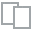
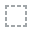
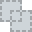
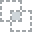
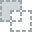
...
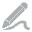
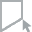
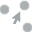
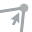
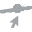

In [3]:
create_report(country)

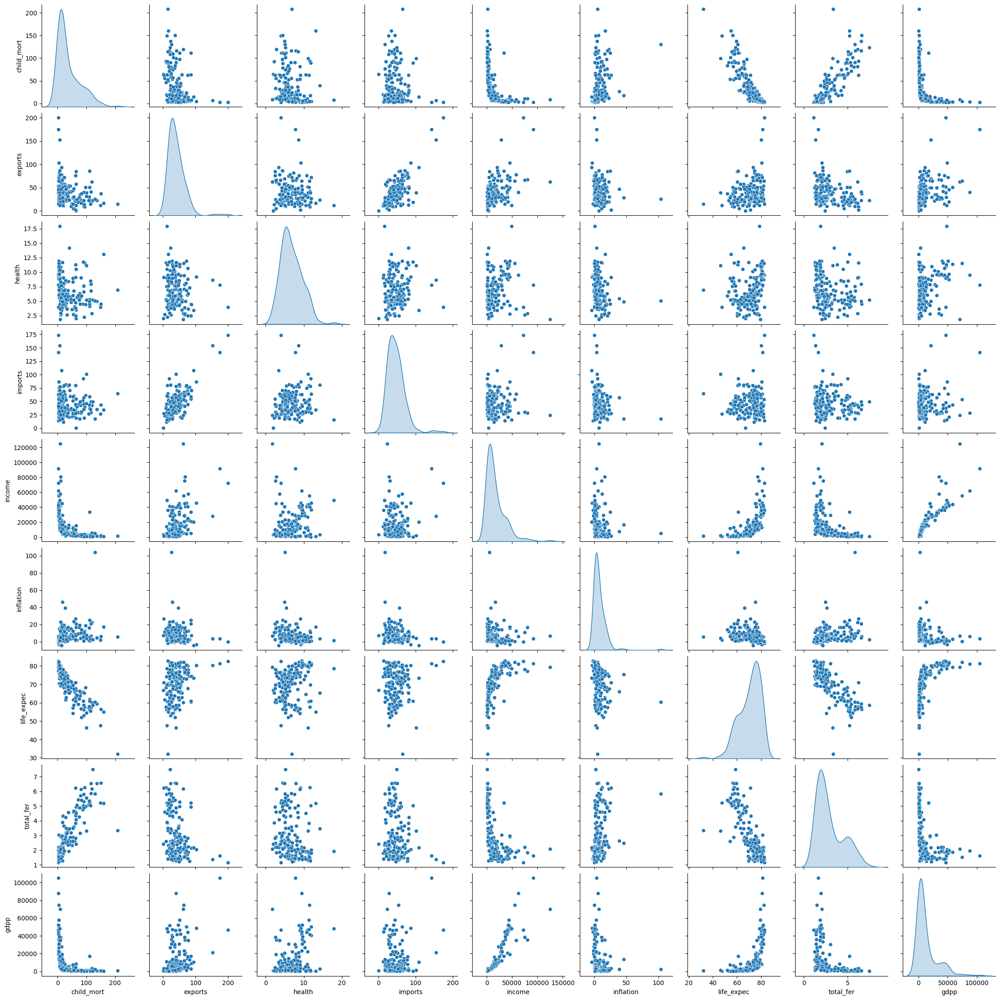

In [4]:
sns.pairplot(country, diag_kind="kde")
plt.show()

### De acordo com o gráfico, e como os dados apresentados pela lib *dataprep* é possível verificar que os valores das variáveis variam bastante. Os valores mínimo e máximo são diferentes para algumas variáveis. As variáveis *income* e *gdpp* são as duas que apresentam os valores máximos mais elevados em comparação às outras variáveis. Neste ponto, o correto a se fazer é transformar os valores para que fiquem no mesmo intervalo.

________________
### Vamos usar a função *np.log* nas variáveis *income* e *gdpp* para deixa-las em um patamar mais perto das outras, e refazer os gráficos

In [5]:
country_log_2 = country.copy()
country_log_2['income'] = np.log(country_log_2['income'])
country_log_2['gdpp'] = np.log(country_log_2['gdpp'])


  0%|          | 0/1784 [00:00<?, ?it/s]

DataPrep Report
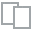
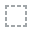
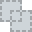
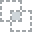
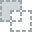
...
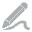
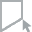
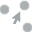
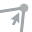
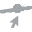

In [6]:
create_report(country_log_2)

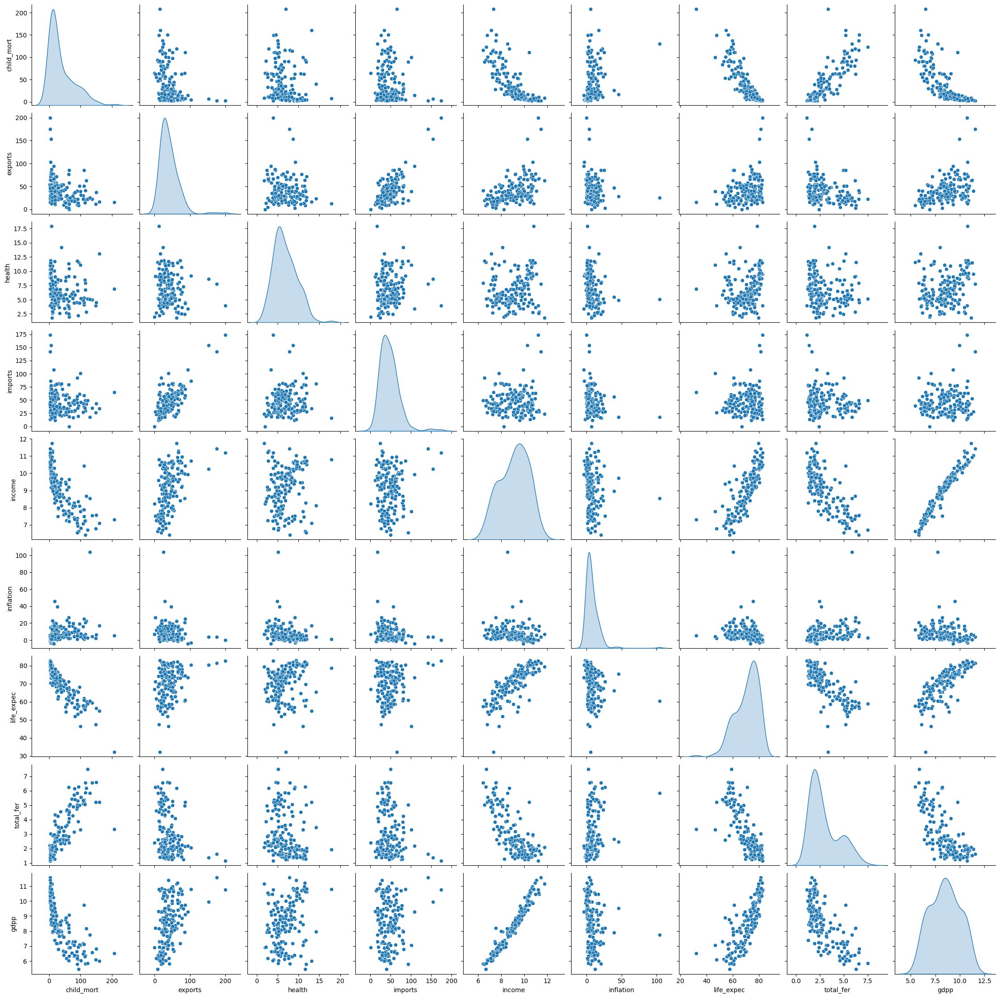

In [7]:
sns.pairplot(country_log_2, diag_kind="kde")
plt.show()

### Temos agora, após usar *np.log* em duas variáveis, uma melhor distrubuião dos patamares de todas as variáveis, fazendo que a minimos e máximos estajam mais próximos no geral

_______________
### Agora vamos usar a mesma função em todas as variáveis

In [8]:
country_log = country.copy()
country_log = np.log(country)

  0%|          | 0/1784 [00:00<?, ?it/s]

DataPrep Report
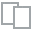
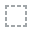
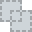
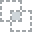
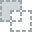
...
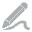
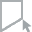
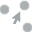
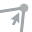
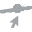

In [9]:
create_report(country_log)

### Como resultado dessa operação, 8 valores foram zerados na coluna *inflation*. Bahamas, República Tcheca, Irlanda, Japã, Latvia, Seichles, Singapura e Slovênia tiveram seus valores zerado, por, provalvemente, terem uma inflação muito perto de zero.

________________
### Por fim, vamos usar a PCA para criar 3 variáveis para diminuir a dimensão do DF, a partir do DF original, depois de usarmos a função StandardScaler

In [10]:
scaler = StandardScaler()
country_scaled = pd.DataFrame(scaler.fit_transform(country), columns=country.columns, index=country.index)

In [11]:
pca = PCA(n_components=3)
data = pca.fit_transform(country_scaled)
country_pca = pd.DataFrame(data)

(<Figure size 640x480 with 2 Axes>, <Axes: >, <Axes: >)

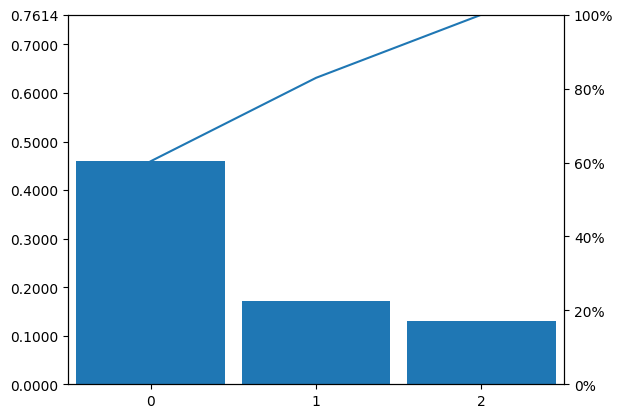

In [12]:
pareto(pca.explained_variance_ratio_)

  0%|          | 0/612 [00:00<?, ?it/s]

DataPrep Report
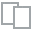
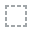
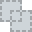
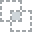
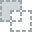
...
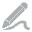
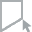
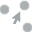
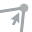
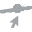

In [13]:
create_report(country_pca)

_______________________________
## A parti de agora vamos usar K-means em cada um dos dados (original, 2-log, all_log, pca) para ver qual o melhor comportamento do algoritmo. Vamos usar *income* e *gdpp* como variáveis base

In [14]:
X1 = 'income'
X2 = 'gdpp'
vars = ['income', 'gdpp']
vars_total = ['child_mort', 'exports', 'health', 'imports', 'income', 'inflation',
       'life_expec', 'total_fer', 'gdpp']

_______________
### Dados originais

In [15]:
model_raw = KMeans(n_clusters=3,
                    n_init=100,
                    max_iter=1000,
                    random_state=42)

model_raw.fit(country[vars])
country['clusters'] = model_raw.predict(country[vars])

In [16]:
cluster_0 = len(country[country['clusters'] == 0])
cluster_1 = len(country[country['clusters'] == 1])
cluster_2 = len(country[country['clusters'] == 2])

In [17]:
print(f"""Cluster 0: {cluster_0}
Cluster 1: {cluster_1}
Cluster 2: {cluster_2}""")

Cluster 0: 128
Cluster 1: 7
Cluster 2: 32


#### Analisando a distribuição e os centroides

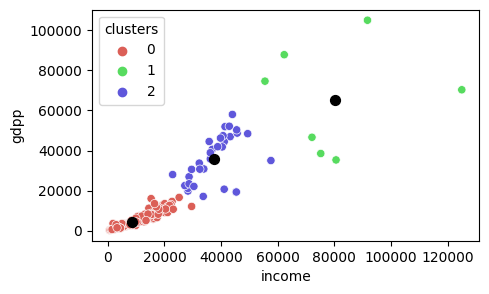

In [18]:
centroids = model_raw.cluster_centers_
plt.figure(figsize = (5,3))
sns.scatterplot(data =country, x=X1,y=X2, hue=country['clusters'],palette=sns.color_palette('hls', 3))

plt.scatter(centroids[:,0], centroids[:,1] , c= 'black', s=50)
plt.show()

In [19]:
cluster_0 = country[country['clusters']==0]
cluster_1 = country[country['clusters']==1]
cluster_2 = country[country['clusters']==2]
cluster_0['dist_2'] = (cluster_0[X1]-centroids[0,0])**2 + (cluster_0[X2]-centroids[0,1])**2
cluster_1['dist_2'] = (cluster_1[X1]-centroids[0,0])**2 + (cluster_1[X2]-centroids[0,1])**2
cluster_2['dist_2'] = (cluster_2[X1]-centroids[0,0])**2 + (cluster_2[X2]-centroids[0,1])**2
index_min_0 = cluster_0['dist_2'][cluster_0['dist_2'] == cluster_0['dist_2'].min()].index
index_min_1 = cluster_1['dist_2'][cluster_1['dist_2'] == cluster_1['dist_2'].min()].index
index_min_2 = cluster_2['dist_2'][cluster_2['dist_2'] == cluster_2['dist_2'].min()].index

In [20]:
print(f"""Os 3 países que representam os cluster nos dados originais são:
Cluster 0: {index_min_0[0]}
Cluster 1: {index_min_1[0]}
Cluster 2: {index_min_2[0]}""")

Os 3 países que representam os cluster nos dados originais são:
Cluster 0: Jamaica
Cluster 1: Kuwait
Cluster 2: Czech Republic


______________
### Dados com LOG em duas variáveis

In [21]:
model_2_log = KMeans(n_clusters=3,
                    n_init=100,
                    max_iter=1000,
                    random_state=42)

model_2_log.fit(country_log_2[vars])
country_log_2['clusters'] = model_2_log.predict(country_log_2[vars])

In [22]:
cluster_0_2 = len(country_log_2[country_log_2['clusters'] == 0])
cluster_1_2 = len(country_log_2[country_log_2['clusters'] == 1])
cluster_2_2 = len(country_log_2[country_log_2['clusters'] == 2])

In [23]:
print(f"""Cluster 0: {cluster_0_2}
Cluster 1: {cluster_1_2}
Cluster 2: {cluster_2_2}""")

Cluster 0: 51
Cluster 1: 74
Cluster 2: 42


#### Analisando a distribuição e os centroides

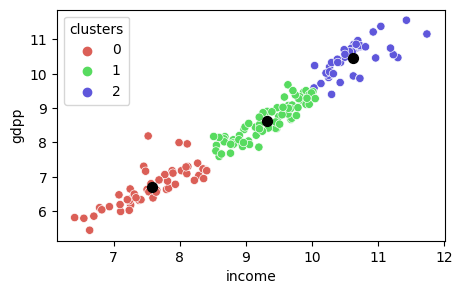

In [24]:
centroids_2 = model_2_log.cluster_centers_
plt.figure(figsize = (5,3))
sns.scatterplot(data =country_log_2, x=X1,y=X2, hue=country_log_2['clusters'],palette=sns.color_palette('hls', 3))

plt.scatter(centroids_2[:,0], centroids_2[:,1] , c= 'black', s=50)
plt.show()

In [25]:
cluster_0_2 = country_log_2[country_log_2['clusters']==0]
cluster_1_2 = country_log_2[country_log_2['clusters']==1]
cluster_2_2 = country_log_2[country_log_2['clusters']==2]
cluster_0_2['dist_2'] = (cluster_0_2[X1]-centroids_2[0,0])**2 + (cluster_0_2[X2]-centroids_2[0,1])**2
cluster_1_2['dist_2'] = (cluster_1_2[X1]-centroids_2[0,0])**2 + (cluster_1_2[X2]-centroids_2[0,1])**2
cluster_2_2['dist_2'] = (cluster_2_2[X1]-centroids_2[0,0])**2 + (cluster_2_2[X2]-centroids_2[0,1])**2
index_min_0_2 = cluster_0_2['dist_2'][cluster_0_2['dist_2'] == cluster_0_2['dist_2'].min()].index
index_min_1_2 = cluster_1_2['dist_2'][cluster_1_2['dist_2'] == cluster_1_2['dist_2'].min()].index
index_min_2_2 = cluster_2_2['dist_2'][cluster_2_2['dist_2'] == cluster_2_2['dist_2'].min()].index

In [26]:
print(f"""Os 3 países que representam os cluster nos dados originais são:
Cluster 0: {index_min_0_2[0]}
Cluster 1: {index_min_1_2[0]}
Cluster 2: {index_min_2_2[0]}""")

Os 3 países que representam os cluster nos dados originais são:
Cluster 0: Chad
Cluster 1: Bolivia
Cluster 2: Estonia


__________
### Dados com todas as variáveis com LOG

In [27]:
model_log = KMeans(n_clusters=3,
                    n_init=100,
                    max_iter=1000,
                    random_state=42)

model_log.fit(country_log[vars])
country_log['clusters'] = model_log.predict(country_log[vars])

In [28]:
cluster_0_all = len(country_log[country_log['clusters'] == 0])
cluster_1_all = len(country_log[country_log['clusters'] == 1])
cluster_2_all = len(country_log[country_log['clusters'] == 2])

In [29]:
print(f"""Cluster 0: {cluster_0_all}
Cluster 1: {cluster_1_all}
Cluster 2: {cluster_2_all}""")

Cluster 0: 51
Cluster 1: 74
Cluster 2: 42


#### Analisando a distribuição e os centroides

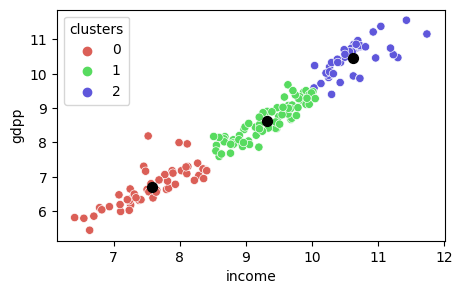

In [30]:
centroids_all = model_log.cluster_centers_
plt.figure(figsize = (5,3))
sns.scatterplot(data =country_log, x=X1,y=X2, hue=country_log['clusters'],palette=sns.color_palette('hls', 3))

plt.scatter(centroids_all[:,0], centroids_all[:,1] , c= 'black', s=50)
plt.show()

In [31]:
cluster_0_all = country_log[country_log['clusters']==0]
cluster_1_all = country_log[country_log['clusters']==1]
cluster_2_all = country_log[country_log['clusters']==2]
cluster_0_all['dist_2'] = (cluster_0_all[X1]-centroids_all[0,0])**2 + (cluster_0_all[X2]-centroids_all[0,1])**2
cluster_1_all['dist_2'] = (cluster_1_all[X1]-centroids_all[0,0])**2 + (cluster_1_all[X2]-centroids_all[0,1])**2
cluster_2_all['dist_2'] = (cluster_2_all[X1]-centroids_all[0,0])**2 + (cluster_2_all[X2]-centroids_all[0,1])**2
index_min_0_all = cluster_0_all['dist_2'][cluster_0_all['dist_2'] == cluster_0_all['dist_2'].min()].index
index_min_1_all = cluster_1_all['dist_2'][cluster_1_all['dist_2'] == cluster_1_all['dist_2'].min()].index
index_min_2_all = cluster_2_all['dist_2'][cluster_2_all['dist_2'] == cluster_2_all['dist_2'].min()].index

In [32]:
print(f"""Os 3 países que representam os cluster nos dados com a função LOG em todas as variáveis são:
Cluster 0: {index_min_0_all[0]}
Cluster 1: {index_min_1_all[0]}
Cluster 2: {index_min_2_all[0]}""")

Os 3 países que representam os cluster nos dados com a função LOG em todas as variáveis são:
Cluster 0: Chad
Cluster 1: Bolivia
Cluster 2: Estonia
